In [1]:
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
!python -V

Python 3.11.2


In [3]:
import binpan
from binpan import handlers

Numba imported


In [4]:
binpan.__version__

'0.8.1'

# Get some data

In [5]:
btcusdt = binpan.Symbol(symbol='btcusdt',
                        tick_interval='1h',
                        limit=1000,
                        time_zone='Europe/Madrid')

2023-11-16	 19:55:41     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1h start=2023-10-06 04:55:41 end=2023-11-16 18:59:58 limit=1000
2023-11-16	 19:55:42     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1h


In [6]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-06 05:00:00+02:00,2023-10-06 05:00:00+02:00,27541.63,27577.00,27530.85,27559.20,438.61026,2023-10-06 05:59:59.999000+02:00,1.208772e+07,20780,222.35339,6.127405e+06,0,1696561200000,1696564799999
2023-10-06 06:00:00+02:00,2023-10-06 06:00:00+02:00,27559.20,27560.97,27488.50,27527.87,729.06805,2023-10-06 06:59:59.999000+02:00,2.006495e+07,23734,377.15769,1.037881e+07,0,1696564800000,1696568399999
2023-10-06 07:00:00+02:00,2023-10-06 07:00:00+02:00,27527.87,27532.00,27477.84,27499.99,474.78645,2023-10-06 07:59:59.999000+02:00,1.305386e+07,22291,211.71828,5.820713e+06,0,1696568400000,1696571999999
2023-10-06 08:00:00+02:00,2023-10-06 08:00:00+02:00,27499.99,27519.40,27464.48,27491.66,551.59393,2023-10-06 08:59:59.999000+02:00,1.516338e+07,23955,317.76655,8.735128e+06,0,1696572000000,1696575599999
2023-10-06 09:00:00+02:00,2023-10-06 09:00:00+02:00,27491.65,27651.00,27482.82,27638.52,1268.68673,2023-10-06 09:59:59.999000+02:00,3.498777e+07,44640,688.12656,1.897521e+07,0,1696575600000,1696579199999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 14:00:00+01:00,2023-11-16 14:00:00+01:00,37127.81,37155.00,36680.00,36770.00,3690.49428,2023-11-16 14:59:59.999000+01:00,1.362062e+08,109027,1600.15747,5.905341e+07,0,1700139600000,1700143199999
2023-11-16 15:00:00+01:00,2023-11-16 15:00:00+01:00,36770.00,36857.24,36426.28,36708.18,3454.97112,2023-11-16 15:59:59.999000+01:00,1.266119e+08,98799,1580.60340,5.793731e+07,0,1700143200000,1700146799999
2023-11-16 16:00:00+01:00,2023-11-16 16:00:00+01:00,36708.18,36912.83,36256.15,36406.00,3458.77619,2023-11-16 16:59:59.999000+01:00,1.264823e+08,110214,1713.19700,6.268501e+07,0,1700146800000,1700150399999


# Adding some indicators

Background color is configurable

2023-11-16	 19:55:43     INFO New column: SMA_21


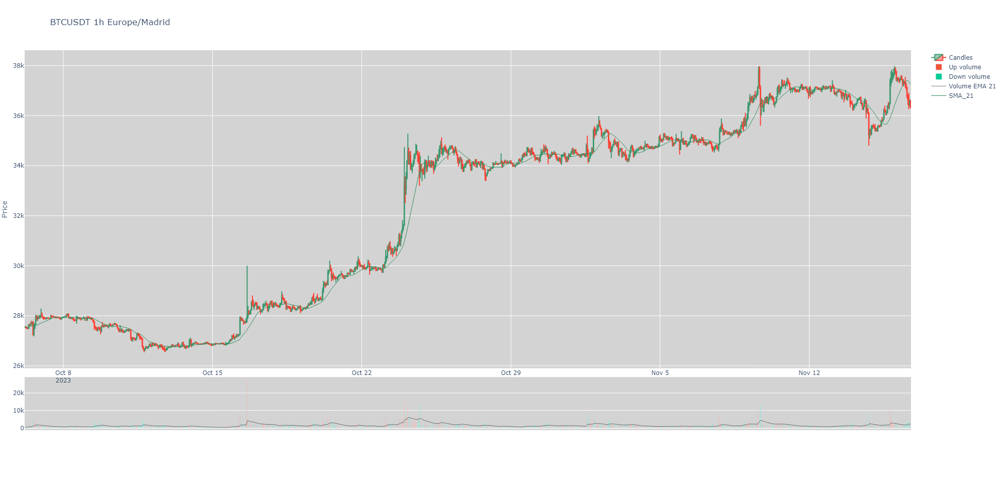

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [7]:
btcusdt.sma(21)

# background color is configurable

btcusdt.plot(background_color='lightgrey')

2023-11-16	 19:55:45     INFO New column: EMA_21


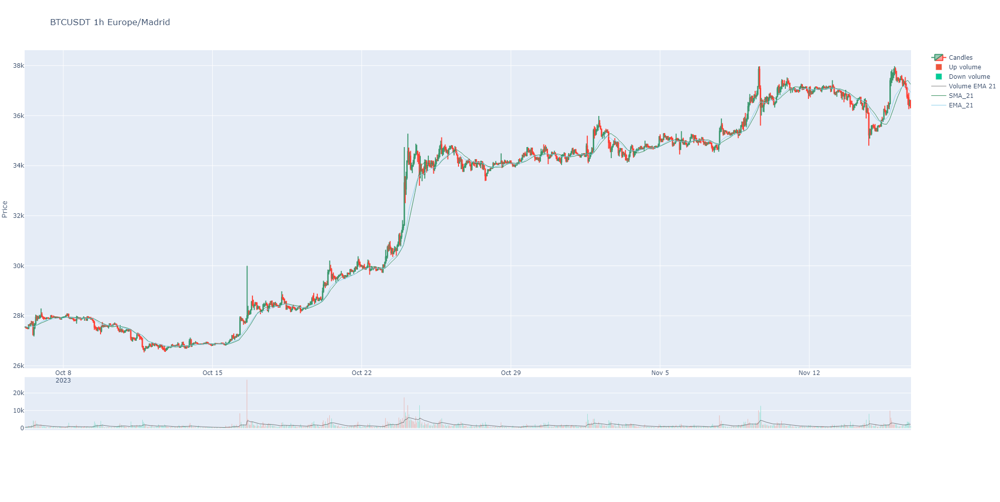

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [8]:
# add ema
btcusdt.ema(21)
btcusdt.plot()

2023-11-16	 19:55:45     INFO New column: zeros
2023-11-16	 19:55:45     INFO New column: MACD_12_26_9
2023-11-16	 19:55:45     INFO New column: MACDh_12_26_9
2023-11-16	 19:55:45     INFO New column: MACDs_12_26_9


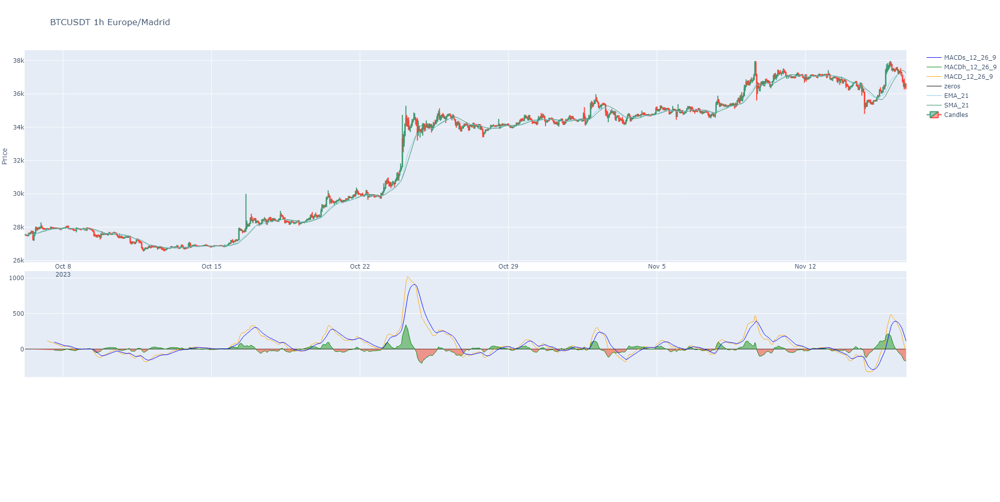

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [9]:
# now with macd
btcusdt.macd()
btcusdt.plot(candles_ta_height_ratio=0.5, volume=False)

2023-11-16	 19:55:47     INFO New column: STOCHRSIk_14_14_3_3
2023-11-16	 19:55:47     INFO New column: STOCHRSId_14_14_3_3


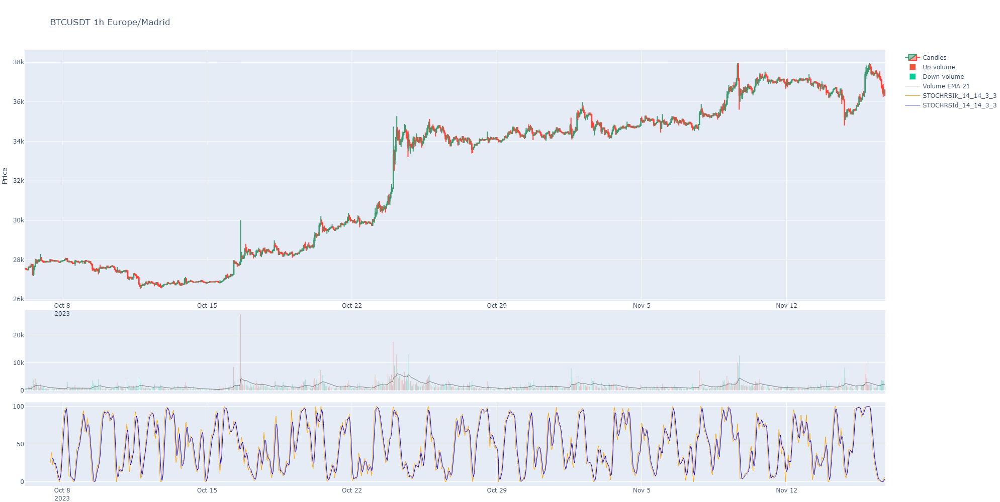

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [10]:
# it is time for stochastic rsi
btcusdt.drop(inplace=True)
btcusdt.stoch_rsi(14,3,3)
btcusdt.plot(candles_ta_height_ratio=0.6)

### Showing the colors applied 

In [11]:
btcusdt.set_plot_color()

{'STOCHRSIk_14_14_3_3': 'orange', 'STOCHRSId_14_14_3_3': 'blue'}

# Example of a generic pandas_ta indicator use:
This indicators are not added to the instance dataframe.

In [12]:
high = btcusdt.df['High']
low = btcusdt.df['Low']
close = btcusdt.df['Close']

rsi = btcusdt.pandas_ta_indicator(name = 'rsi',
                            high=high,
                            low=low, 
                            close=close,
                            length=16,
                            rsi_length=16,
                            k=3,
                            d=3)
rsi

This indicator should be plotted manually with the plotting module. Check docs for candles_ta functions and pass it as an indicator serie. Example: candles_ta(data=btcusdt.df, indicators_series=[rsi])


BTCUSDT 1h Europe/Madrid
2023-10-06 05:00:00+02:00          NaN
2023-10-06 06:00:00+02:00          NaN
2023-10-06 07:00:00+02:00          NaN
2023-10-06 08:00:00+02:00          NaN
2023-10-06 09:00:00+02:00          NaN
                               ...    
2023-11-16 14:00:00+01:00    43.970776
2023-11-16 15:00:00+01:00    42.626104
2023-11-16 16:00:00+01:00    36.764153
2023-11-16 17:00:00+01:00    41.271133
2023-11-16 18:00:00+01:00    36.828935
Name: RSI_16, Length: 999, dtype: float64

# No automated plot, because generic pandas_ta calls are not added to instances.

But can be plotted manually, example.

2023-11-16	 19:55:47     INFO Indicators random colors:  indicators_colors=['darkgreen']
2023-11-16	 19:55:47     INFO Inferred positions, sent all to bottom subplot: rows_pos=[2]


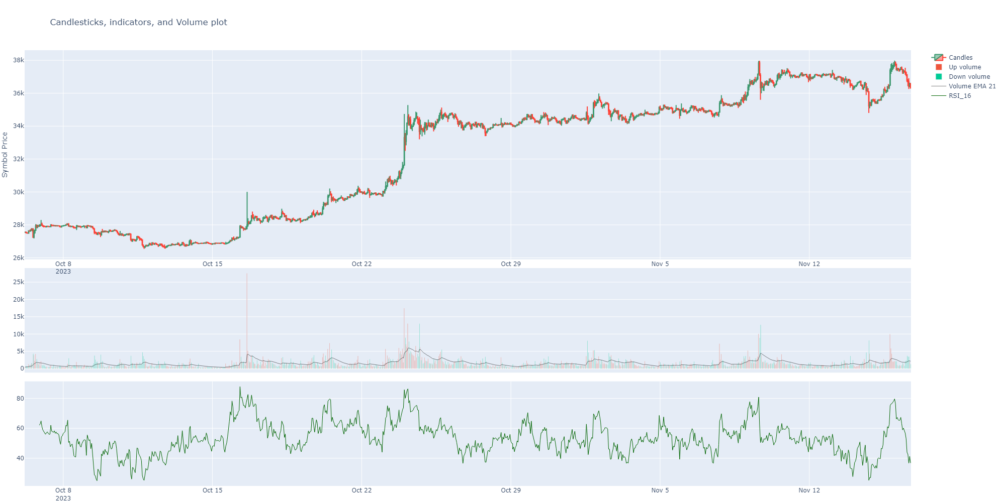

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [13]:
handlers.plotting.candles_ta(data=btcusdt.df, indicators_series=rsi)

In [14]:
# manual indicators are not added automatically to btcusdt.df
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,STOCHRSIk_14_14_3_3,STOCHRSId_14_14_3_3
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,
2023-10-06 05:00:00+02:00,2023-10-06 05:00:00+02:00,27541.63,27577.00,27530.85,27559.20,438.61026,2023-10-06 05:59:59.999000+02:00,1.208772e+07,20780,222.35339,6.127405e+06,0,1696561200000,1696564799999,NaN,NaN
2023-10-06 06:00:00+02:00,2023-10-06 06:00:00+02:00,27559.20,27560.97,27488.50,27527.87,729.06805,2023-10-06 06:59:59.999000+02:00,2.006495e+07,23734,377.15769,1.037881e+07,0,1696564800000,1696568399999,NaN,NaN
2023-10-06 07:00:00+02:00,2023-10-06 07:00:00+02:00,27527.87,27532.00,27477.84,27499.99,474.78645,2023-10-06 07:59:59.999000+02:00,1.305386e+07,22291,211.71828,5.820713e+06,0,1696568400000,1696571999999,NaN,NaN
2023-10-06 08:00:00+02:00,2023-10-06 08:00:00+02:00,27499.99,27519.40,27464.48,27491.66,551.59393,2023-10-06 08:59:59.999000+02:00,1.516338e+07,23955,317.76655,8.735128e+06,0,1696572000000,1696575599999,NaN,NaN
2023-10-06 09:00:00+02:00,2023-10-06 09:00:00+02:00,27491.65,27651.00,27482.82,27638.52,1268.68673,2023-10-06 09:59:59.999000+02:00,3.498777e+07,44640,688.12656,1.897521e+07,0,1696575600000,1696579199999,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 14:00:00+01:00,2023-11-16 14:00:00+01:00,37127.81,37155.00,36680.00,36770.00,3690.49428,2023-11-16 14:59:59.999000+01:00,1.362062e+08,109027,1600.15747,5.905341e+07,0,1700139600000,1700143199999,0.000000,0.621687
2023-11-16 15:00:00+01:00,2023-11-16 15:00:00+01:00,36770.00,36857.24,36426.28,36708.18,3454.97112,2023-11-16 15:59:59.999000+01:00,1.266119e+08,98799,1580.60340,5.793731e+07,0,1700143200000,1700146799999,0.000000,0.000000
2023-11-16 16:00:00+01:00,2023-11-16 16:00:00+01:00,36708.18,36912.83,36256.15,36406.00,3458.77619,2023-11-16 16:59:59.999000+01:00,1.264823e+08,110214,1713.19700,6.268501e+07,0,1700146800000,1700150399999,0.000000,0.000000


# Cleaning data
Before plotting more indicators, let's drop some indicators.

In [15]:
btcusdt.row_control

{'STOCHRSIk_14_14_3_3': 2, 'STOCHRSId_14_14_3_3': 2}

In [16]:
btcusdt.df.columns

Index(['Open time', 'Open', 'High', 'Low', 'Close', 'Volume', 'Close time', 'Quote volume', 'Trades', 'Taker buy base volume', 'Taker buy quote volume', 'Ignore', 'Open timestamp', 'Close timestamp', 'STOCHRSIk_14_14_3_3', 'STOCHRSId_14_14_3_3'], dtype='object')

In [17]:
btcusdt.drop(columns_to_drop=['STOCHRSIk_14_14_3_3', 'STOCHRSId_14_14_3_3'], inplace=True)
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-06 05:00:00+02:00,2023-10-06 05:00:00+02:00,27541.63,27577.00,27530.85,27559.20,438.61026,2023-10-06 05:59:59.999000+02:00,1.208772e+07,20780,222.35339,6.127405e+06,0,1696561200000,1696564799999
2023-10-06 06:00:00+02:00,2023-10-06 06:00:00+02:00,27559.20,27560.97,27488.50,27527.87,729.06805,2023-10-06 06:59:59.999000+02:00,2.006495e+07,23734,377.15769,1.037881e+07,0,1696564800000,1696568399999
2023-10-06 07:00:00+02:00,2023-10-06 07:00:00+02:00,27527.87,27532.00,27477.84,27499.99,474.78645,2023-10-06 07:59:59.999000+02:00,1.305386e+07,22291,211.71828,5.820713e+06,0,1696568400000,1696571999999
2023-10-06 08:00:00+02:00,2023-10-06 08:00:00+02:00,27499.99,27519.40,27464.48,27491.66,551.59393,2023-10-06 08:59:59.999000+02:00,1.516338e+07,23955,317.76655,8.735128e+06,0,1696572000000,1696575599999
2023-10-06 09:00:00+02:00,2023-10-06 09:00:00+02:00,27491.65,27651.00,27482.82,27638.52,1268.68673,2023-10-06 09:59:59.999000+02:00,3.498777e+07,44640,688.12656,1.897521e+07,0,1696575600000,1696579199999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 14:00:00+01:00,2023-11-16 14:00:00+01:00,37127.81,37155.00,36680.00,36770.00,3690.49428,2023-11-16 14:59:59.999000+01:00,1.362062e+08,109027,1600.15747,5.905341e+07,0,1700139600000,1700143199999
2023-11-16 15:00:00+01:00,2023-11-16 15:00:00+01:00,36770.00,36857.24,36426.28,36708.18,3454.97112,2023-11-16 15:59:59.999000+01:00,1.266119e+08,98799,1580.60340,5.793731e+07,0,1700143200000,1700146799999
2023-11-16 16:00:00+01:00,2023-11-16 16:00:00+01:00,36708.18,36912.83,36256.15,36406.00,3458.77619,2023-11-16 16:59:59.999000+01:00,1.264823e+08,110214,1713.19700,6.268501e+07,0,1700146800000,1700150399999


# Not dropped indicators are kept on plot control

In [18]:
# maybe not this time, cause no indicator
btcusdt.row_control

{}

# Continuing with more indicators

2023-11-16	 19:55:48     INFO New column: SUPERT_10_3.0
2023-11-16	 19:55:48     INFO New column: SUPERTd_10_3.0
2023-11-16	 19:55:48     INFO New column: SUPERTl_10_3.0
2023-11-16	 19:55:48     INFO New column: SUPERTs_10_3.0


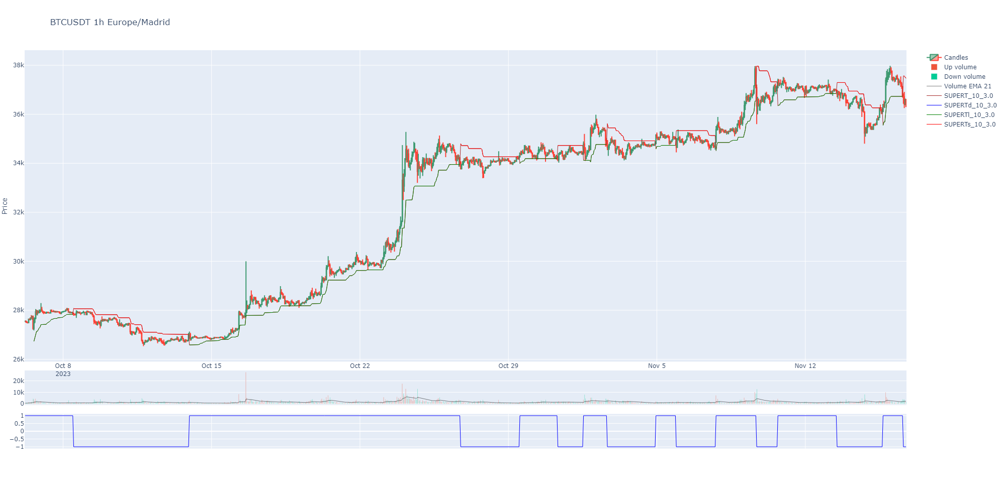

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [19]:
btcusdt.supertrend(length=10, multiplier=3)
btcusdt.plot()

In [20]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,,,
2023-10-06 05:00:00+02:00,2023-10-06 05:00:00+02:00,27541.63,27577.00,27530.85,27559.20,438.61026,2023-10-06 05:59:59.999000+02:00,1.208772e+07,20780,222.35339,6.127405e+06,0,1696561200000,1696564799999,NaN,1,NaN,NaN
2023-10-06 06:00:00+02:00,2023-10-06 06:00:00+02:00,27559.20,27560.97,27488.50,27527.87,729.06805,2023-10-06 06:59:59.999000+02:00,2.006495e+07,23734,377.15769,1.037881e+07,0,1696564800000,1696568399999,NaN,1,NaN,NaN
2023-10-06 07:00:00+02:00,2023-10-06 07:00:00+02:00,27527.87,27532.00,27477.84,27499.99,474.78645,2023-10-06 07:59:59.999000+02:00,1.305386e+07,22291,211.71828,5.820713e+06,0,1696568400000,1696571999999,NaN,1,NaN,NaN
2023-10-06 08:00:00+02:00,2023-10-06 08:00:00+02:00,27499.99,27519.40,27464.48,27491.66,551.59393,2023-10-06 08:59:59.999000+02:00,1.516338e+07,23955,317.76655,8.735128e+06,0,1696572000000,1696575599999,NaN,1,NaN,NaN
2023-10-06 09:00:00+02:00,2023-10-06 09:00:00+02:00,27491.65,27651.00,27482.82,27638.52,1268.68673,2023-10-06 09:59:59.999000+02:00,3.498777e+07,44640,688.12656,1.897521e+07,0,1696575600000,1696579199999,NaN,1,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 14:00:00+01:00,2023-11-16 14:00:00+01:00,37127.81,37155.00,36680.00,36770.00,3690.49428,2023-11-16 14:59:59.999000+01:00,1.362062e+08,109027,1600.15747,5.905341e+07,0,1700139600000,1700143199999,36730.294850,1,36730.29485,NaN
2023-11-16 15:00:00+01:00,2023-11-16 15:00:00+01:00,36770.00,36857.24,36426.28,36708.18,3454.97112,2023-11-16 15:59:59.999000+01:00,1.266119e+08,98799,1580.60340,5.793731e+07,0,1700143200000,1700146799999,37563.154877,-1,NaN,37563.154877
2023-11-16 16:00:00+01:00,2023-11-16 16:00:00+01:00,36708.18,36912.83,36256.15,36406.00,3458.77619,2023-11-16 16:59:59.999000+01:00,1.264823e+08,110214,1713.19700,6.268501e+07,0,1700146800000,1700150399999,37563.154877,-1,NaN,37563.154877


2023-11-16	 19:55:49     INFO New column: OBV


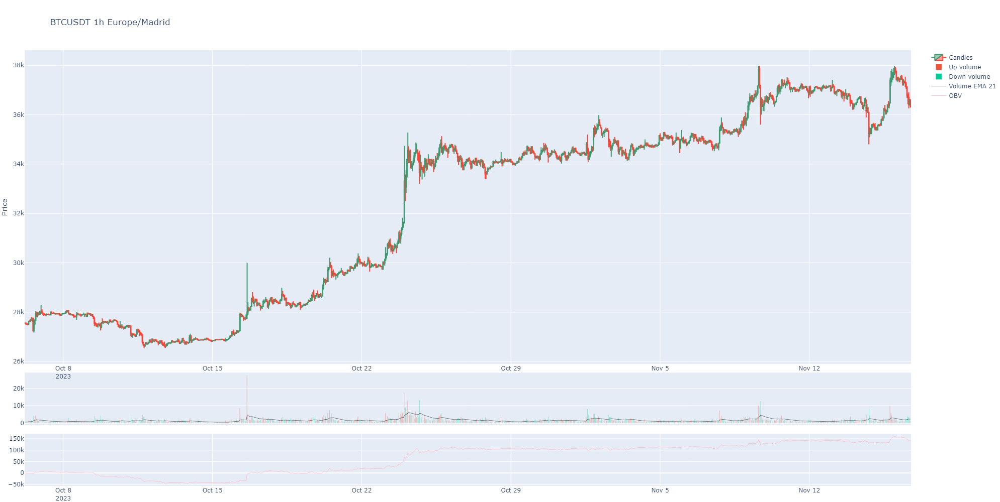

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [21]:
btcusdt.drop(inplace=True)
btcusdt.on_balance_volume()
btcusdt.plot()

In [22]:
btcusdt.row_counter

2

In [23]:
btcusdt.row_control

{'OBV': 2}

2023-11-16	 19:55:49     INFO New column: RSI_14


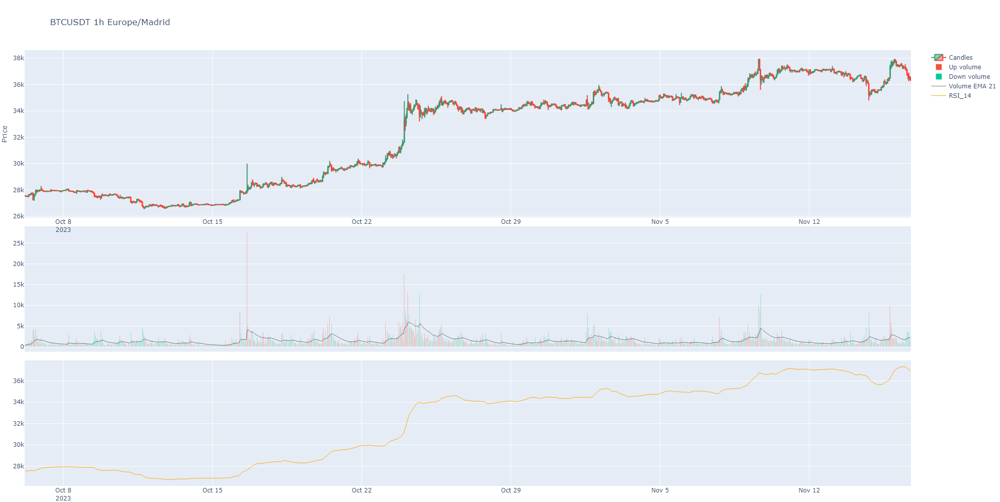

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [24]:
btcusdt.drop(inplace=True)
btcusdt.rsi(length=14)
btcusdt.plot(candles_ta_height_ratio=0.4)

### Repeating request for an indicator don't adds it to the plot control

2023-11-16	 19:55:50     INFO Existing column: RSI_14 -> No data added to instance.


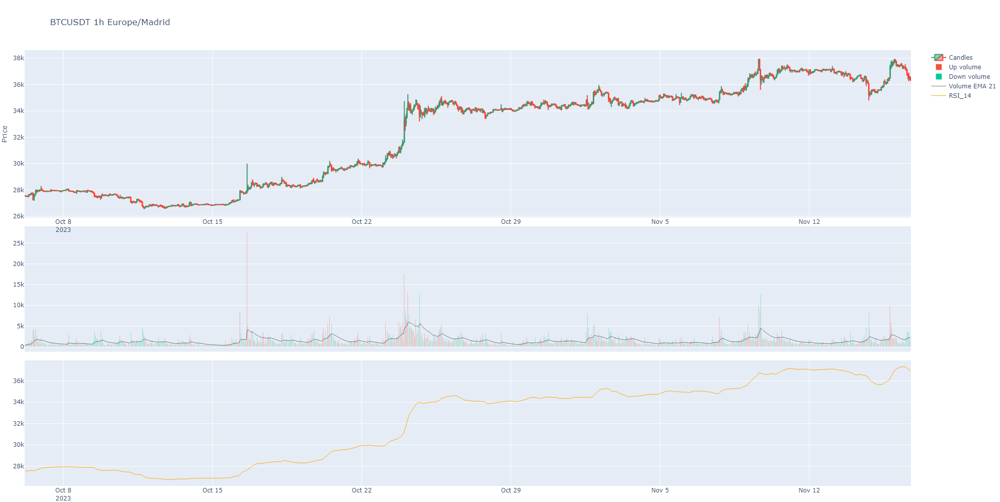

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [25]:
btcusdt.rsi(length=14)
btcusdt.plot(candles_ta_height_ratio=0.4)

In [26]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,RSI_14
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,
2023-10-06 05:00:00+02:00,2023-10-06 05:00:00+02:00,27541.63,27577.00,27530.85,27559.20,438.61026,2023-10-06 05:59:59.999000+02:00,1.208772e+07,20780,222.35339,6.127405e+06,0,1696561200000,1696564799999,27559.200000
2023-10-06 06:00:00+02:00,2023-10-06 06:00:00+02:00,27559.20,27560.97,27488.50,27527.87,729.06805,2023-10-06 06:59:59.999000+02:00,2.006495e+07,23734,377.15769,1.037881e+07,0,1696564800000,1696568399999,27555.022667
2023-10-06 07:00:00+02:00,2023-10-06 07:00:00+02:00,27527.87,27532.00,27477.84,27499.99,474.78645,2023-10-06 07:59:59.999000+02:00,1.305386e+07,22291,211.71828,5.820713e+06,0,1696568400000,1696571999999,27547.684978
2023-10-06 08:00:00+02:00,2023-10-06 08:00:00+02:00,27499.99,27519.40,27464.48,27491.66,551.59393,2023-10-06 08:59:59.999000+02:00,1.516338e+07,23955,317.76655,8.735128e+06,0,1696572000000,1696575599999,27540.214981
2023-10-06 09:00:00+02:00,2023-10-06 09:00:00+02:00,27491.65,27651.00,27482.82,27638.52,1268.68673,2023-10-06 09:59:59.999000+02:00,3.498777e+07,44640,688.12656,1.897521e+07,0,1696575600000,1696579199999,27553.322317
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 14:00:00+01:00,2023-11-16 14:00:00+01:00,37127.81,37155.00,36680.00,36770.00,3690.49428,2023-11-16 14:59:59.999000+01:00,1.362062e+08,109027,1600.15747,5.905341e+07,0,1700139600000,1700143199999,37220.006054
2023-11-16 15:00:00+01:00,2023-11-16 15:00:00+01:00,36770.00,36857.24,36426.28,36708.18,3454.97112,2023-11-16 15:59:59.999000+01:00,1.266119e+08,98799,1580.60340,5.793731e+07,0,1700143200000,1700146799999,37151.762580
2023-11-16 16:00:00+01:00,2023-11-16 16:00:00+01:00,36708.18,36912.83,36256.15,36406.00,3458.77619,2023-11-16 16:59:59.999000+01:00,1.264823e+08,110214,1713.19700,6.268501e+07,0,1700146800000,1700150399999,37052.327570


In [27]:
btcusdt.row_counter

2

In [28]:
btcusdt.row_control

{'RSI_14': 2}

### Adding more indicators

2023-11-16	 19:55:51     INFO New column: AD


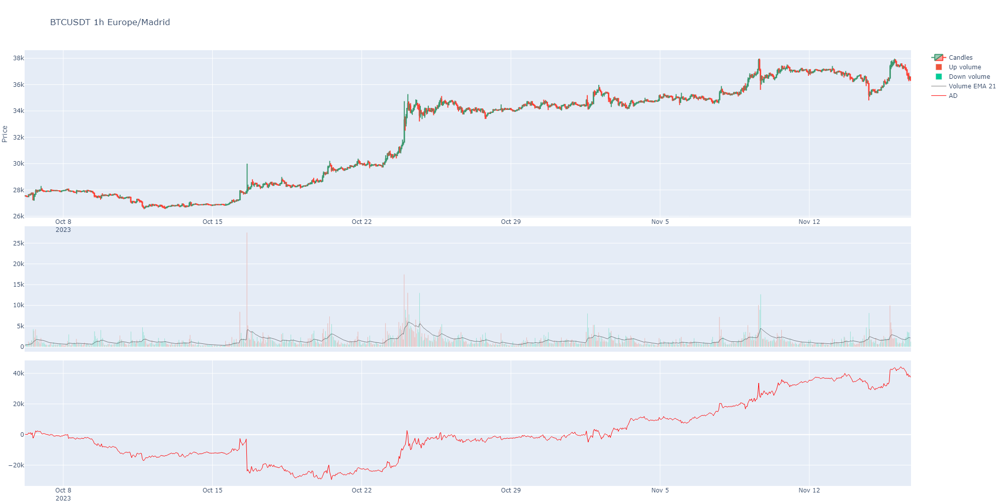

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [29]:
btcusdt.drop(inplace=True)
btcusdt.accumulation_distribution()
btcusdt.plot(candles_ta_height_ratio=0.4)

## Cleaning again

In [30]:
btcusdt.drop(inplace=True)
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-06 05:00:00+02:00,2023-10-06 05:00:00+02:00,27541.63,27577.00,27530.85,27559.20,438.61026,2023-10-06 05:59:59.999000+02:00,1.208772e+07,20780,222.35339,6.127405e+06,0,1696561200000,1696564799999
2023-10-06 06:00:00+02:00,2023-10-06 06:00:00+02:00,27559.20,27560.97,27488.50,27527.87,729.06805,2023-10-06 06:59:59.999000+02:00,2.006495e+07,23734,377.15769,1.037881e+07,0,1696564800000,1696568399999
2023-10-06 07:00:00+02:00,2023-10-06 07:00:00+02:00,27527.87,27532.00,27477.84,27499.99,474.78645,2023-10-06 07:59:59.999000+02:00,1.305386e+07,22291,211.71828,5.820713e+06,0,1696568400000,1696571999999
2023-10-06 08:00:00+02:00,2023-10-06 08:00:00+02:00,27499.99,27519.40,27464.48,27491.66,551.59393,2023-10-06 08:59:59.999000+02:00,1.516338e+07,23955,317.76655,8.735128e+06,0,1696572000000,1696575599999
2023-10-06 09:00:00+02:00,2023-10-06 09:00:00+02:00,27491.65,27651.00,27482.82,27638.52,1268.68673,2023-10-06 09:59:59.999000+02:00,3.498777e+07,44640,688.12656,1.897521e+07,0,1696575600000,1696579199999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 14:00:00+01:00,2023-11-16 14:00:00+01:00,37127.81,37155.00,36680.00,36770.00,3690.49428,2023-11-16 14:59:59.999000+01:00,1.362062e+08,109027,1600.15747,5.905341e+07,0,1700139600000,1700143199999
2023-11-16 15:00:00+01:00,2023-11-16 15:00:00+01:00,36770.00,36857.24,36426.28,36708.18,3454.97112,2023-11-16 15:59:59.999000+01:00,1.266119e+08,98799,1580.60340,5.793731e+07,0,1700143200000,1700146799999
2023-11-16 16:00:00+01:00,2023-11-16 16:00:00+01:00,36708.18,36912.83,36256.15,36406.00,3458.77619,2023-11-16 16:59:59.999000+01:00,1.264823e+08,110214,1713.19700,6.268501e+07,0,1700146800000,1700150399999


C:\Users\hanca\PycharmProjects\binpan_studio\binpan\symbol_manager.py:2633: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.

2023-11-16	 19:55:51     INFO New column: VWAP_D


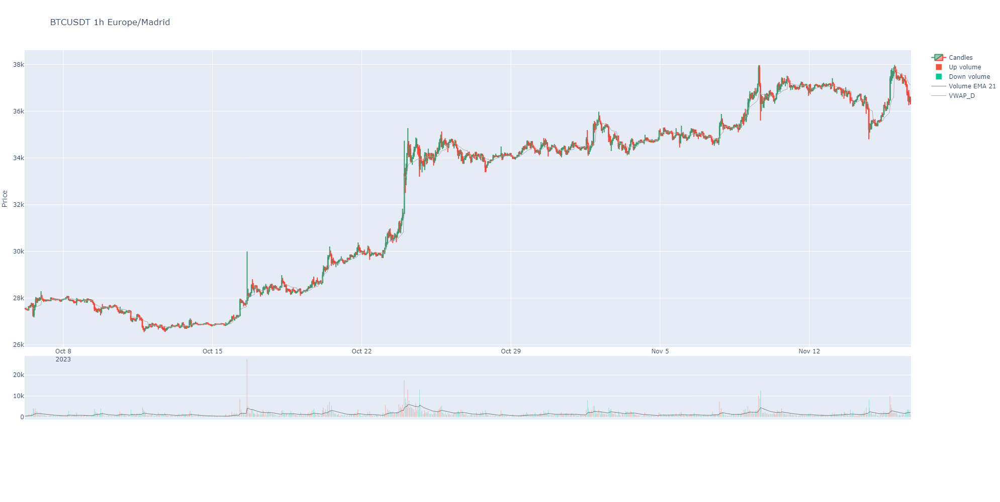

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [31]:
btcusdt.vwap()
btcusdt.plot(candles_ta_height_ratio=0.7)

# maybe, you get a pandas_ta library warning

2023-11-16	 19:55:52     INFO New column: ATRr_14


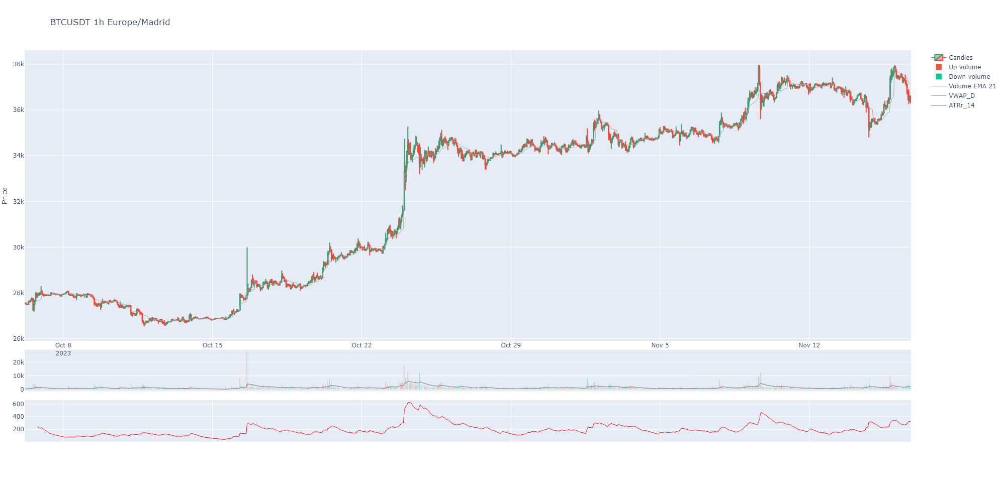

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [32]:
btcusdt.atr()
btcusdt.plot(candles_ta_height_ratio=0.7)

2023-11-16	 19:55:52     INFO New column: CCI_14_0.015


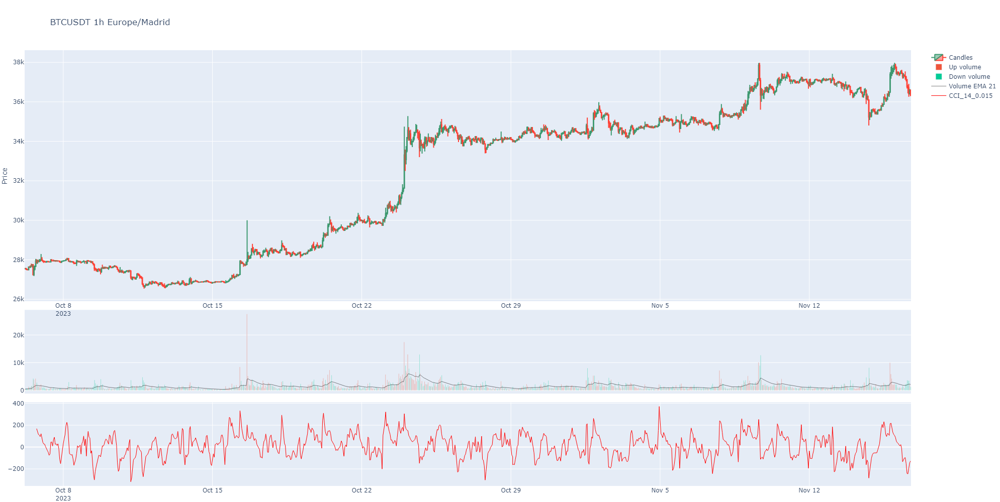

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [33]:
btcusdt.drop(inplace=True)
btcusdt.cci()
btcusdt.plot(candles_ta_height_ratio=0.6)

2023-11-16	 19:55:53     INFO New column: EOM_14_100000000


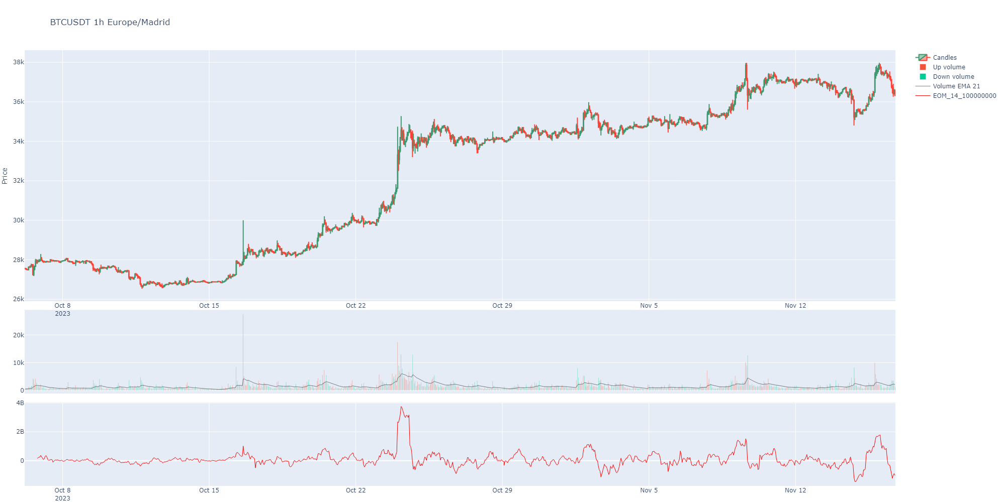

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [34]:
btcusdt.drop(inplace=True)
btcusdt.eom(length=14, divisor=100000000, drift=1)
btcusdt.plot(candles_ta_height_ratio=0.6)

2023-11-16	 19:55:53     INFO New column: ROC_1


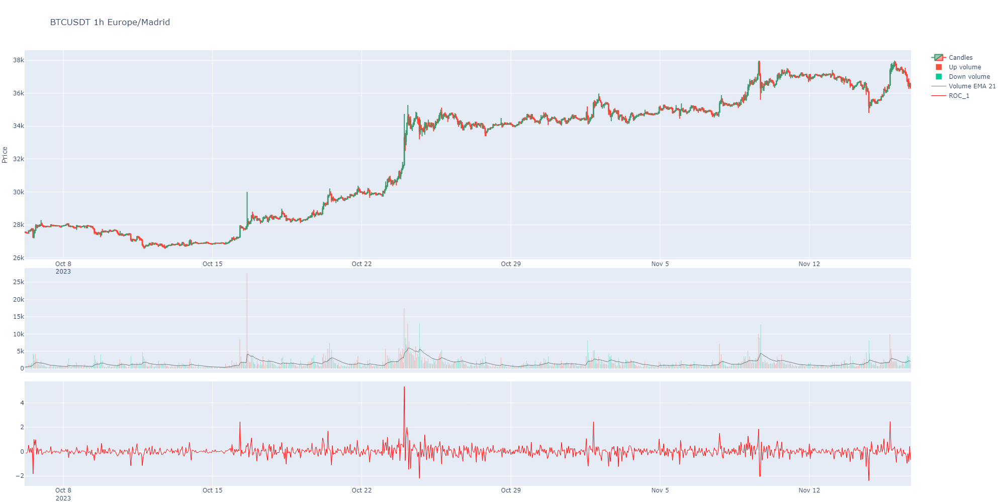

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [35]:
btcusdt.drop(inplace=True)
btcusdt.roc()
btcusdt.plot(candles_ta_height_ratio=0.5)

2023-11-16	 19:55:54     INFO New column: Ichimoku_tenkan_9
2023-11-16	 19:55:54     INFO New column: Ichimoku_kijun_26
2023-11-16	 19:55:54     INFO New column: Ichimoku_chikou_span26
2023-11-16	 19:55:54     INFO New column: Ichimoku_cloud_9_26
2023-11-16	 19:55:54     INFO New column: Ichimoku_cloud_52


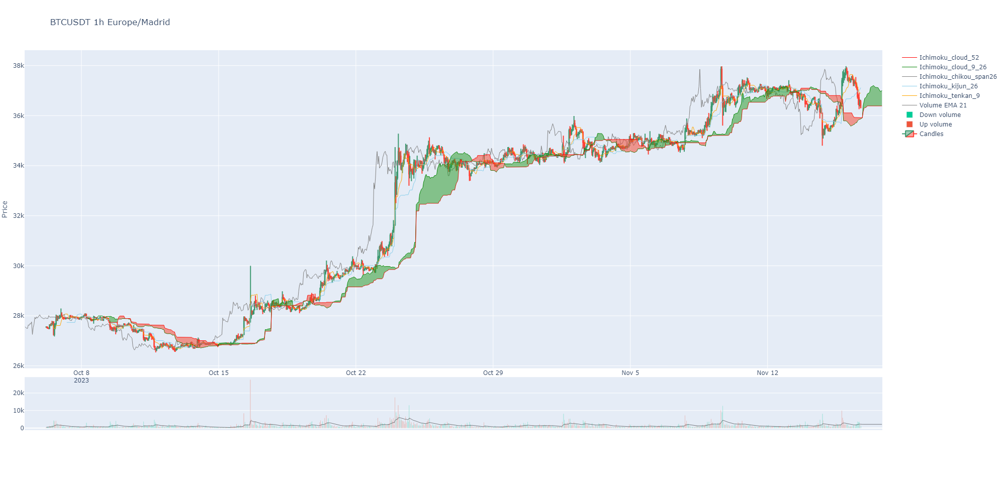

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [36]:
btcusdt.drop(inplace=True)
btcusdt.ichimoku()
btcusdt.plot()

2023-11-16	 19:55:55     INFO New column: BBL_5_2.0_
2023-11-16	 19:55:55     INFO New column: BBM_5_2.0_
2023-11-16	 19:55:55     INFO New column: BBU_5_2.0_
2023-11-16	 19:55:55     INFO New column: BBB_5_2.0_
2023-11-16	 19:55:55     INFO New column: BBP_5_2.0_


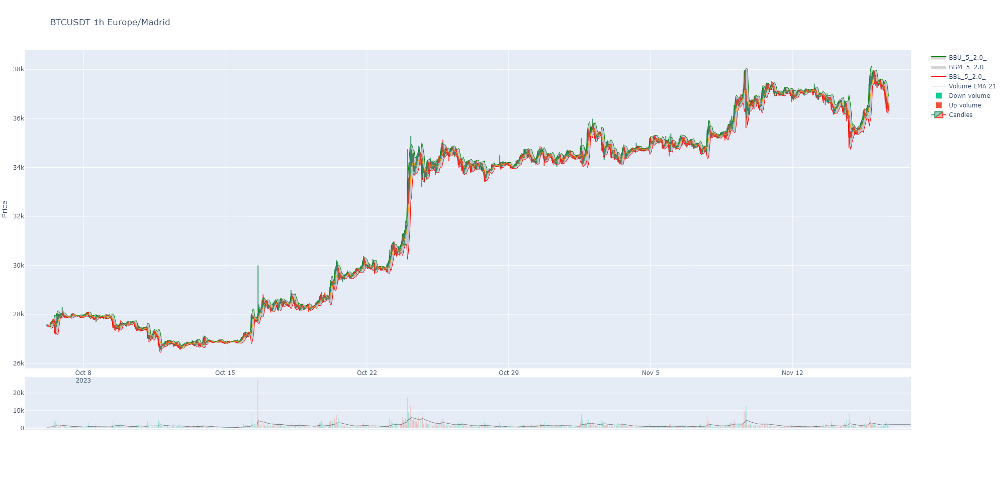

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [37]:
btcusdt.drop(inplace=True)
btcusdt.bbands()
btcusdt.plot()

In [38]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,BBL_5_2.0_,BBM_5_2.0_,BBU_5_2.0_,BBB_5_2.0_,BBP_5_2.0_
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,,,,
2023-10-05 03:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-05 04:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-05 05:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-05 06:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-05 07:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-17 16:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-11-17 17:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-11-17 18:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Clean for Stochastic Oscillator

In [39]:
btcusdt = binpan.Symbol(symbol='BTCUSDT', tick_interval='1m', time_zone='Europe/Madrid')
btcusdt.df

2023-11-16	 19:55:56     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-16 03:15:56 end=2023-11-16 19:54:58 limit=1000
2023-11-16	 19:55:56     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1m


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,
2023-11-16 03:16:00+01:00,2023-11-16 03:16:00+01:00,37498.99,37508.26,37475.34,37481.46,30.92287,2023-11-16 03:16:59.999000+01:00,1.159462e+06,1130,21.90361,8.213023e+05,0,1700100960000,1700101019999
2023-11-16 03:17:00+01:00,2023-11-16 03:17:00+01:00,37481.47,37484.45,37461.11,37481.09,17.09411,2023-11-16 03:17:59.999000+01:00,6.405188e+05,789,9.29832,3.483745e+05,0,1700101020000,1700101079999
2023-11-16 03:18:00+01:00,2023-11-16 03:18:00+01:00,37481.10,37481.10,37465.00,37465.00,12.92867,2023-11-16 03:18:59.999000+01:00,4.844440e+05,665,4.03039,1.510222e+05,0,1700101080000,1700101139999
2023-11-16 03:19:00+01:00,2023-11-16 03:19:00+01:00,37465.01,37489.28,37464.62,37489.27,7.99788,2023-11-16 03:19:59.999000+01:00,2.997077e+05,648,3.25519,1.219866e+05,0,1700101140000,1700101199999
2023-11-16 03:20:00+01:00,2023-11-16 03:20:00+01:00,37489.28,37513.12,37486.01,37507.49,19.37281,2023-11-16 03:20:59.999000+01:00,7.264795e+05,881,8.28976,3.108665e+05,0,1700101200000,1700101259999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 19:50:00+01:00,2023-11-16 19:50:00+01:00,36144.56,36165.57,36105.01,36105.98,28.77816,2023-11-16 19:50:59.999000+01:00,1.039703e+06,1093,8.49377,3.068982e+05,0,1700160600000,1700160659999
2023-11-16 19:51:00+01:00,2023-11-16 19:51:00+01:00,36105.99,36158.39,36105.98,36158.39,31.81728,2023-11-16 19:51:59.999000+01:00,1.149598e+06,945,20.66095,7.463661e+05,0,1700160660000,1700160719999
2023-11-16 19:52:00+01:00,2023-11-16 19:52:00+01:00,36158.38,36215.23,36142.54,36208.90,39.37534,2023-11-16 19:52:59.999000+01:00,1.424497e+06,1050,32.27586,1.167726e+06,0,1700160720000,1700160779999


In [40]:
btcusdt.stoch()

2023-11-16	 19:55:57     INFO New column: STOCHk_14_3_3
2023-11-16	 19:55:57     INFO New column: STOCHd_14_3_3


,STOCHk_14_3_3,STOCHd_14_3_3
BTCUSDT 1m Europe/Madrid,,
2023-11-16 03:29:00+01:00,NaN,NaN
2023-11-16 03:30:00+01:00,NaN,NaN
2023-11-16 03:31:00+01:00,28.596002,NaN
2023-11-16 03:32:00+01:00,40.974301,NaN
2023-11-16 03:33:00+01:00,57.972959,42.514421
...,...,...
2023-11-16 19:50:00+01:00,3.790267,11.803048
2023-11-16 19:51:00+01:00,12.730172,10.719681
2023-11-16 19:52:00+01:00,29.139022,15.219821


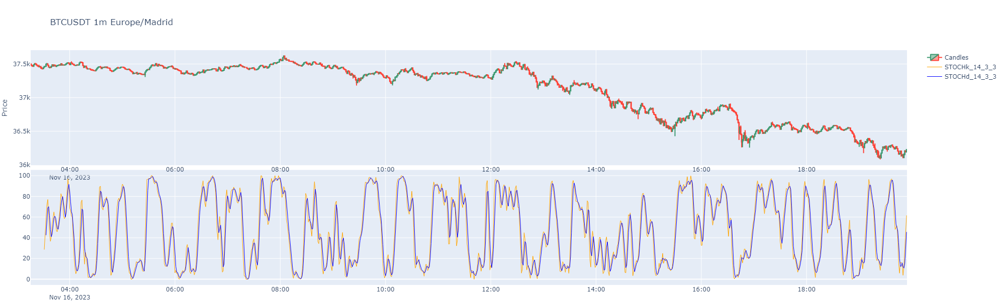

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [41]:
btcusdt.plot(volume=False, height=600, candles_ta_height_ratio=0.5)

# Simple indicator addition by insertion

In [42]:
btcusdt = binpan.Symbol(symbol='BTCUSDT', tick_interval='1m', time_zone='Europe/Madrid')
btcusdt.df

2023-11-16	 19:55:58     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-16 03:15:58 end=2023-11-16 19:54:58 limit=1000
2023-11-16	 19:55:58     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1m


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,
2023-11-16 03:16:00+01:00,2023-11-16 03:16:00+01:00,37498.99,37508.26,37475.34,37481.46,30.92287,2023-11-16 03:16:59.999000+01:00,1.159462e+06,1130,21.90361,8.213023e+05,0,1700100960000,1700101019999
2023-11-16 03:17:00+01:00,2023-11-16 03:17:00+01:00,37481.47,37484.45,37461.11,37481.09,17.09411,2023-11-16 03:17:59.999000+01:00,6.405188e+05,789,9.29832,3.483745e+05,0,1700101020000,1700101079999
2023-11-16 03:18:00+01:00,2023-11-16 03:18:00+01:00,37481.10,37481.10,37465.00,37465.00,12.92867,2023-11-16 03:18:59.999000+01:00,4.844440e+05,665,4.03039,1.510222e+05,0,1700101080000,1700101139999
2023-11-16 03:19:00+01:00,2023-11-16 03:19:00+01:00,37465.01,37489.28,37464.62,37489.27,7.99788,2023-11-16 03:19:59.999000+01:00,2.997077e+05,648,3.25519,1.219866e+05,0,1700101140000,1700101199999
2023-11-16 03:20:00+01:00,2023-11-16 03:20:00+01:00,37489.28,37513.12,37486.01,37507.49,19.37281,2023-11-16 03:20:59.999000+01:00,7.264795e+05,881,8.28976,3.108665e+05,0,1700101200000,1700101259999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 19:50:00+01:00,2023-11-16 19:50:00+01:00,36144.56,36165.57,36105.01,36105.98,28.77816,2023-11-16 19:50:59.999000+01:00,1.039703e+06,1093,8.49377,3.068982e+05,0,1700160600000,1700160659999
2023-11-16 19:51:00+01:00,2023-11-16 19:51:00+01:00,36105.99,36158.39,36105.98,36158.39,31.81728,2023-11-16 19:51:59.999000+01:00,1.149598e+06,945,20.66095,7.463661e+05,0,1700160660000,1700160719999
2023-11-16 19:52:00+01:00,2023-11-16 19:52:00+01:00,36158.38,36215.23,36142.54,36208.90,39.37534,2023-11-16 19:52:59.999000+01:00,1.424497e+06,1050,32.27586,1.167726e+06,0,1700160720000,1700160779999


In [43]:
volume_diff = btcusdt.df['Volume'].diff()
volume_diff

BTCUSDT 1m Europe/Madrid
2023-11-16 03:16:00+01:00         NaN
2023-11-16 03:17:00+01:00   -13.82876
2023-11-16 03:18:00+01:00    -4.16544
2023-11-16 03:19:00+01:00    -4.93079
2023-11-16 03:20:00+01:00    11.37493
                               ...   
2023-11-16 19:50:00+01:00     5.24706
2023-11-16 19:51:00+01:00     3.03912
2023-11-16 19:52:00+01:00     7.55806
2023-11-16 19:53:00+01:00   -21.28728
2023-11-16 19:54:00+01:00    -3.20235
Name: Volume, Length: 999, dtype: float64

In [44]:
zero = volume_diff*0
zero

BTCUSDT 1m Europe/Madrid
2023-11-16 03:16:00+01:00    NaN
2023-11-16 03:17:00+01:00   -0.0
2023-11-16 03:18:00+01:00   -0.0
2023-11-16 03:19:00+01:00   -0.0
2023-11-16 03:20:00+01:00    0.0
                            ... 
2023-11-16 19:50:00+01:00    0.0
2023-11-16 19:51:00+01:00    0.0
2023-11-16 19:52:00+01:00    0.0
2023-11-16 19:53:00+01:00   -0.0
2023-11-16 19:54:00+01:00   -0.0
Name: Volume, Length: 999, dtype: float64

In [45]:
btcusdt.insert_indicator(source_data=[volume_diff, zero], plotting_rows=[2,2], names=['Volume_diff', 'Zero'], colors=['blue', 'darkgrey'])
btcusdt.row_control

2023-11-16	 19:55:58     INFO New column: Volume_diff
2023-11-16	 19:55:58     INFO New column: Zero


{'Volume_diff': 2, 'Zero': 3}

In [46]:
btcusdt.set_plot_row('Zero', 2)
btcusdt.row_control

{'Volume_diff': 2, 'Zero': 2}

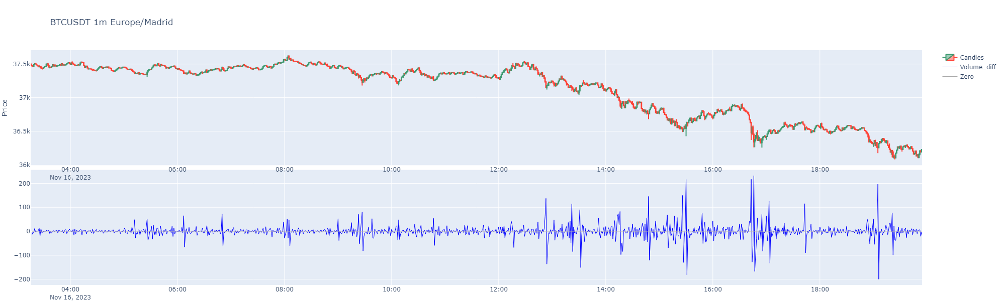

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [47]:
btcusdt.plot(volume=False, height=600, candles_ta_height_ratio=0.5)

## Check for 3 positive volume differences in a row.
This was just an experiment.

In [48]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,Volume_diff,Zero
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,,,
2023-11-16 03:16:00+01:00,2023-11-16 03:16:00+01:00,37498.99,37508.26,37475.34,37481.46,30.92287,2023-11-16 03:16:59.999000+01:00,1.159462e+06,1130,21.90361,8.213023e+05,0,1700100960000,1700101019999,NaN,NaN
2023-11-16 03:17:00+01:00,2023-11-16 03:17:00+01:00,37481.47,37484.45,37461.11,37481.09,17.09411,2023-11-16 03:17:59.999000+01:00,6.405188e+05,789,9.29832,3.483745e+05,0,1700101020000,1700101079999,-13.82876,-0.0
2023-11-16 03:18:00+01:00,2023-11-16 03:18:00+01:00,37481.10,37481.10,37465.00,37465.00,12.92867,2023-11-16 03:18:59.999000+01:00,4.844440e+05,665,4.03039,1.510222e+05,0,1700101080000,1700101139999,-4.16544,-0.0
2023-11-16 03:19:00+01:00,2023-11-16 03:19:00+01:00,37465.01,37489.28,37464.62,37489.27,7.99788,2023-11-16 03:19:59.999000+01:00,2.997077e+05,648,3.25519,1.219866e+05,0,1700101140000,1700101199999,-4.93079,-0.0
2023-11-16 03:20:00+01:00,2023-11-16 03:20:00+01:00,37489.28,37513.12,37486.01,37507.49,19.37281,2023-11-16 03:20:59.999000+01:00,7.264795e+05,881,8.28976,3.108665e+05,0,1700101200000,1700101259999,11.37493,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-16 19:50:00+01:00,2023-11-16 19:50:00+01:00,36144.56,36165.57,36105.01,36105.98,28.77816,2023-11-16 19:50:59.999000+01:00,1.039703e+06,1093,8.49377,3.068982e+05,0,1700160600000,1700160659999,5.24706,0.0
2023-11-16 19:51:00+01:00,2023-11-16 19:51:00+01:00,36105.99,36158.39,36105.98,36158.39,31.81728,2023-11-16 19:51:59.999000+01:00,1.149598e+06,945,20.66095,7.463661e+05,0,1700160660000,1700160719999,3.03912,0.0
2023-11-16 19:52:00+01:00,2023-11-16 19:52:00+01:00,36158.38,36215.23,36142.54,36208.90,39.37534,2023-11-16 19:52:59.999000+01:00,1.424497e+06,1050,32.27586,1.167726e+06,0,1700160720000,1700160779999,7.55806,0.0


In [49]:
positive_col_row = btcusdt.df['Volume_diff'].rolling(window=3).agg(lambda x: (x > 0).sum())
positive_col_row[positive_col_row==3]

BTCUSDT 1m Europe/Madrid
2023-11-16 03:24:00+01:00    3.0
2023-11-16 03:25:00+01:00    3.0
2023-11-16 03:35:00+01:00    3.0
2023-11-16 03:36:00+01:00    3.0
2023-11-16 03:45:00+01:00    3.0
                            ... 
2023-11-16 18:54:00+01:00    3.0
2023-11-16 19:15:00+01:00    3.0
2023-11-16 19:19:00+01:00    3.0
2023-11-16 19:36:00+01:00    3.0
2023-11-16 19:52:00+01:00    3.0
Name: Volume_diff, Length: 57, dtype: float64

# Fractal

In [50]:
sym = binpan.Symbol(symbol='ltcusdt',
                        tick_interval='1h',
                        limit=200,
                        time_zone='Europe/Madrid')

2023-11-16	 19:55:59     INFO get_candles_by_time_stamps -> symbol=LTCUSDT tick_interval=1h start=2023-11-08 11:55:59 end=2023-11-16 18:59:58 limit=200
2023-11-16	 19:55:59  WARNING API response missing 800 klines for LTCUSDT 2023-11-08 11:55:59 to 2023-11-16 19:55:59 expected 1000 got 200
2023-11-16	 19:55:59     INFO Pruned overtime_candle_ts 1 candles from API response for LTCUSDT 1h


In [51]:
sym.fractal(period=5)

2023-11-16	 19:56:00     INFO New column: Fractal_W_5
2023-11-16	 19:56:00     INFO New column: Fractal_W_5_values


,Fractal_W_5,Fractal_W_5_values
LTCUSDT 1h Europe/Madrid,,
2023-11-08 12:00:00+01:00,0.0,NaN
2023-11-08 13:00:00+01:00,0.0,NaN
2023-11-08 14:00:00+01:00,0.0,NaN
2023-11-08 15:00:00+01:00,0.0,NaN
2023-11-08 16:00:00+01:00,0.0,NaN
...,...,...
2023-11-16 14:00:00+01:00,0.0,NaN
2023-11-16 15:00:00+01:00,0.0,NaN
2023-11-16 16:00:00+01:00,0.0,NaN


In [52]:
sym.color_control

{'Fractal_W_5': 'black', 'Fractal_W_5_values': 'black'}

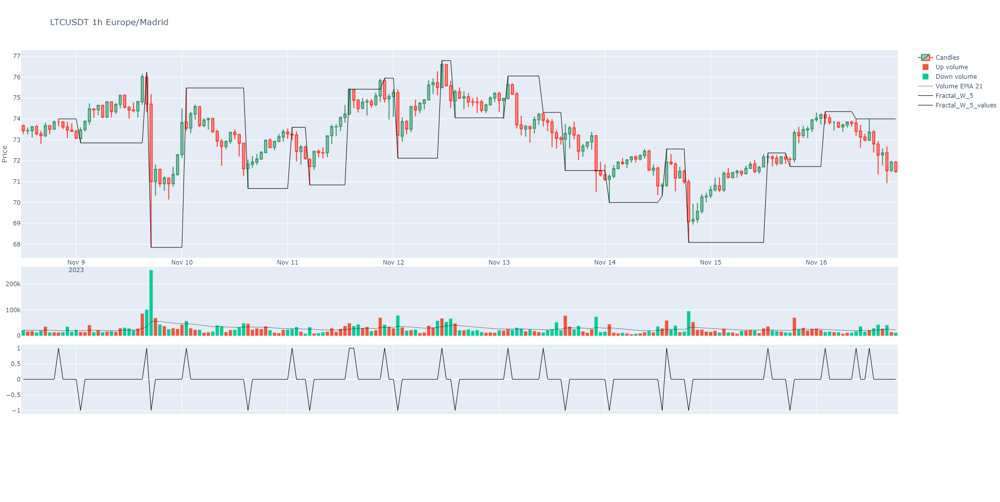

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [53]:
sym.plot(candles_ta_height_ratio=0.5)

# Alternating Fractal
This custom indicator shows the minimum period in finding a pure alternating fractal. It is some kind of volatility in price indicator, the most period needed, the most volatile price.

In [54]:
sym = binpan.Symbol(symbol='btcusdt',
                        tick_interval='1m',
                        limit=2000,
                        time_zone='Europe/Madrid')

2023-11-16	 19:56:00     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-15 10:36:00 end=2023-11-16 19:55:58 limit=1000
2023-11-16	 19:56:01     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1m


In [55]:
fractal, maximums_mean, minimums_mean = sym.alternating_fractal(max_period=1000, overlap_plot=True, with_trend=True)
maximums_mean, minimums_mean

Searching for pure alternating fractal...


  0%|          | 0/998 [00:00<?, ?it/s]

2023-11-16	 19:56:11     INFO Decreasing maxima and decreasing minima. downtrend
2023-11-16	 19:56:11     INFO Max mean: -218.0 Min mean: -126.37000000000262
2023-11-16	 19:56:11     INFO New column: Fractal_W_185
2023-11-16	 19:56:11     INFO New column: Fractal_W_185_values


Pure alternating fractal found at period=185
Maximum_max_diff=-77.09999999999854
Minimum_max_diff=-358.90000000000146
Maximum_min_diff=-126.37000000000262
Minimum_min_diff=-126.37000000000262
Decreasing maxima and decreasing minima. downtrend


(-218.0, -126.37000000000262)

In [56]:
fractal.dropna()

,Fractal_W_185,Fractal_W_185_values
BTCUSDT 1m Europe/Madrid,,
2023-11-16 00:56:00+01:00,1.0,37980.00
2023-11-16 05:26:00+01:00,-1.0,37307.55
2023-11-16 08:05:00+01:00,1.0,37621.10
2023-11-16 09:27:00+01:00,-1.0,37181.18
2023-11-16 12:29:00+01:00,1.0,37544.00


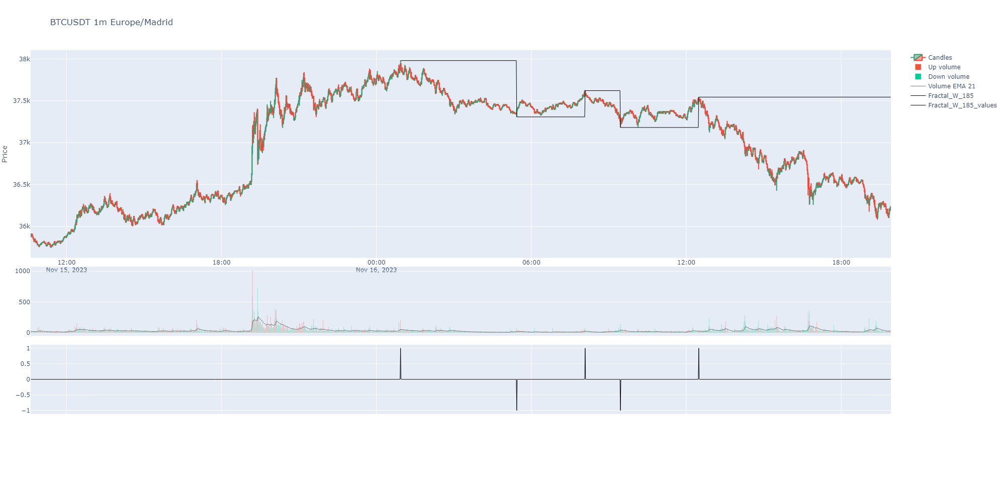

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [57]:
sym.plot(candles_ta_height_ratio=0.5)

# Market Profile Indicator

In [58]:
mp = sym.get_market_profile(bins=100)
mp

2023-11-16	 19:56:12     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
C:\Users\hanca\PycharmProjects\binpan_studio\handlers\indicators.py:1080: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,Taker buy base volume,Maker buy base volume
Price_Bin_BTCUSDT 1m Europe/Madrid_Klines,,
"(35752.578, 35776.688]",120.35433,209.58907
"(35776.688, 35798.606]",238.06780,180.98084
"(35798.606, 35820.524]",220.32108,211.95568
"(35820.524, 35842.443]",84.66098,93.95729
"(35842.443, 35864.361]",29.19121,25.63170
...,...,...
"(37836.996, 37858.914]",225.39327,238.23366
"(37858.914, 37880.832]",345.70318,328.00522
"(37880.832, 37902.75]",15.30132,29.76996


2023-11-16	 19:56:12     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
C:\Users\hanca\PycharmProjects\binpan_studio\handlers\plotting.py:1384: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



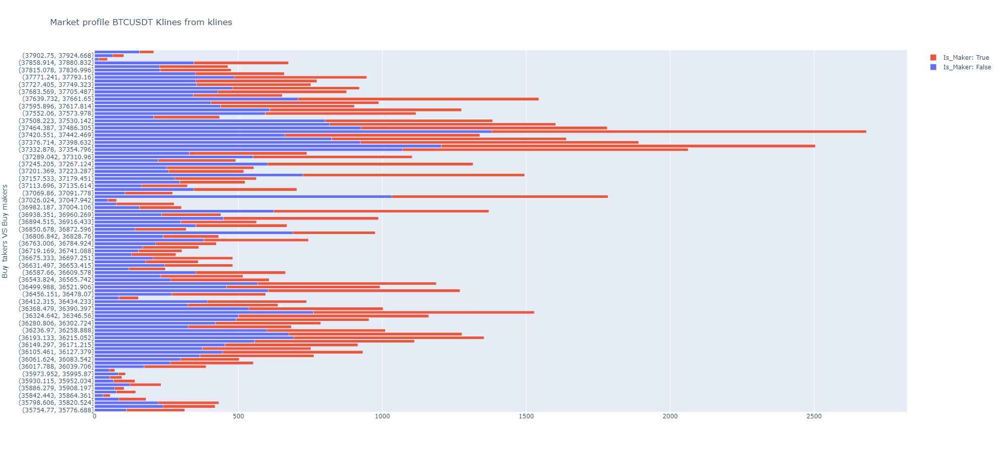

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [59]:
sym.plot_market_profile()

# Taker Maker ratio by price leves

In [60]:
sym.get_taker_maker_ratio_profile()

Price_Bin_BTCUSDT 1m Europe/Madrid_Klines
(35752.578, 35776.688]    0.364773
(35776.688, 35798.606]    0.568115
(35798.606, 35820.524]    0.509676
(35820.524, 35842.443]    0.473977
(35842.443, 35864.361]    0.532464
                            ...   
(37836.996, 37858.914]    0.486152
(37858.914, 37880.832]    0.513135
(37880.832, 37902.75]     0.339492
(37902.75, 37924.668]     0.619611
(37924.668, 37946.587]    0.762875
Length: 100, dtype: float64

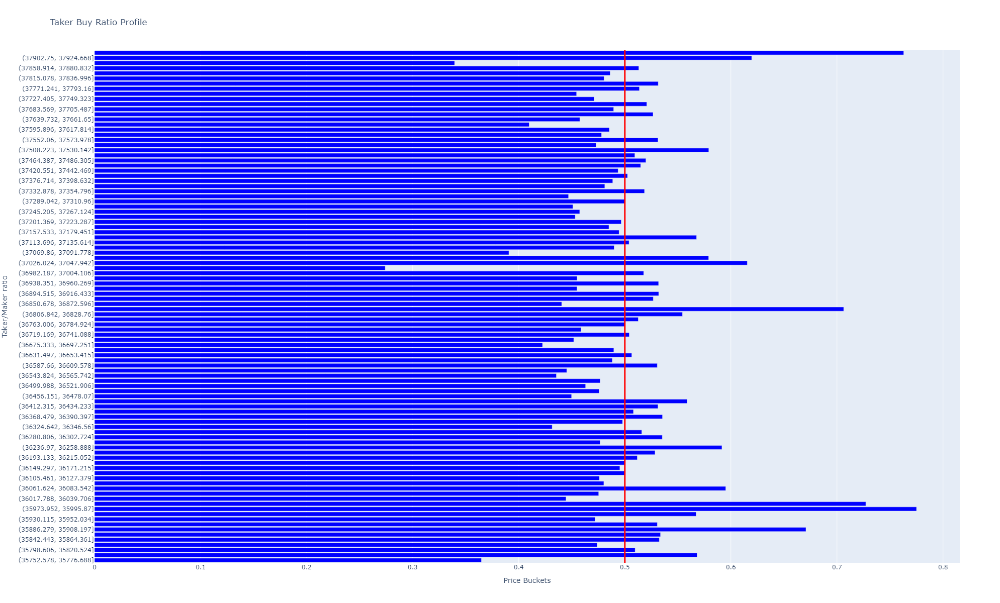

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [61]:
sym.plot_taker_maker_ratio_profile()